In [32]:
from sstadex import Macromodel, Primitive, Test, dfs, simplediffpair, cs_pmos, cm_pmos, spice_sim, diffpair_cc, current_mirror_cc
import numpy as np
from sympy import Symbol
from sympy.solvers import solve
import matplotlib.pyplot as plt
import paretoset as pareto
import pandas as pd
from sympy import lambdify
from sstadex import Transistor
import seaborn as sns
sns.set_theme()
sns.color_palette("mako")

[(0.18195582, 0.11955283, 0.23136943),
 (0.25307401, 0.23772973, 0.48316271),
 (0.21607792, 0.39736958, 0.61948028),
 (0.20344718, 0.56074869, 0.65649508),
 (0.25187832, 0.71827158, 0.67872193),
 (0.54578602, 0.8544913, 0.69848331)]

In [33]:
import sys

sys.path.insert(0, "../../..")
from gmid.mosplot import load_lookup_table, LoadMosfet

In [34]:
## Exploration parameters

N_points = 10
lengths = [0.4e-06, 0.8e-06, 1.6e-06, 3.2e-06, 6.4e-6]

## Electrical parameters

Vout = 1.2                                      # LDO output voltage
Vin = 3.3                                       # LDO supply voltage
Vref = 0.9                                      # LDO voltage reference
IL = 100e-3                                     # Load current
CL = 0.5e-12                                    # Load capacitance
RL = Vout/IL

## LDO specifications

efficiency = 0.99
psrr_condition = -70
estability_condition = 60
linereg_condition = 0.5
loadreg_condition = 0.7
#iq_condition = 20e-6
size_condition = 1e-3

I_bias = 5e-6
I_amp1 = 40e-6 # considering the two branches of differential pair
I_amp2 = 40e-6

Iq_max = IL*(1-efficiency)
Ib_pt = Iq_max-I_amp1-I_amp2-I_bias

R1 = (Vout-Vref)/Ib_pt
R2 = Vref*R1/(Vout-Vref)

LDO = pd.DataFrame.from_dict({'Vout': [Vout], 'Vin': [Vin], 'Vref': [Vref], 'IL': [IL], 'CL': [CL], 'RL': [RL], 'Iq_max': [Iq_max], 'Ib_pt': [Ib_pt], 'R1': [R1], 'R2': [R2]}, orient='index', columns=['Value'])
LDO

,Value
Vout,1.200000e+00
Vin,3.300000e+00
Vref,9.000000e-01
IL,1.000000e-01
CL,5.000000e-13
RL,1.200000e+01
Iq_max,1.000000e-03
Ib_pt,9.150000e-04
R1,3.278689e+02
R2,9.836066e+02


# Preparation

## Macromodel

In [35]:
V2stage_out = np.linspace(Vout-Vin+0.6, Vout-Vin-0.6, 5)

LDO_macro = Macromodel(
    name ='LDO_macro', 
    outputs= [
        Symbol("W_pt"), Symbol("L_pt")],
    electrical_parameters={
        "Vdd": Vin, 
        "Vref": Vref, 
        "Vout": Vout, 
        "V2stage_out": V2stage_out,
        "Il": IL+Ib_pt}
    )

LDO_macro.area_conditions = {
    "max": [100e-3, 100e-3, 100e-3, 100e-3, 100e-3, 100e-3, 10, 100e-3, 100e-3, 100e-3, 100e-3, 100e-3, 100e-3],
    "min": [5e-6, 0, 5e-6, 0, 5e-6, 0, 0, 5e-6, 0, 5e-6, 0, 5e-6, 0]}

OTA_2stage_macro = Macromodel(
    name = 'OTA_2stage_macro',
    outputs = [
        Symbol("W_2stage"), Symbol("L_2stage"),
        Symbol('W_cs_2stage'), Symbol('L_cs_2stage')],
    electrical_parameters = {
        "Vdd": LDO_macro.electrical_parameters["Vdd"],
        "Vref": LDO_macro.electrical_parameters["Vref"],
        "Vout": LDO_macro.electrical_parameters["V2stage_out"],
        "V1stage_out": 1.6,
        "Il": I_amp2},
    macromodel_parameters={
        Symbol('Ra'): np.logspace(3, 7, N_points),
        Symbol('gma'): np.logspace(-5, -2, N_points),
        Symbol('Ca'): np.logspace(-17, -12, N_points)}
    )
OTA_2stage_macro.area_conditions = {
    "max": [100e-3, 100e-3, 100e-3, 100e-3, 100e-3, 100e-3, 10, 100e-3, 100e-3, 100e-3, 100e-3],
    "min": [5e-6, 0, 5e-6, 0, 5e-6, 0, 0, 5e-6, 0, 5e-6, 0]}

OTA_1stage_macro = Macromodel(
    name = 'OTA_1stage_macro',
    outputs = [
        Symbol("W_diff"), Symbol("L_diff"), 
        Symbol("W_al"), Symbol("L_al"),
        Symbol("W_cs"), Symbol("L_cs"),
        Symbol('vgs_cs')],
    electrical_parameters = {
        "Vdd": OTA_2stage_macro.electrical_parameters["Vdd"],
        "Vref": OTA_2stage_macro.electrical_parameters["Vref"],
        "Vout": OTA_2stage_macro.electrical_parameters["V1stage_out"],
        "Il": I_amp1},
    macromodel_parameters={Symbol('Ra_1stage'): np.logspace(3, 7, 5),
                                              Symbol('gma_1stage'): np.logspace(-5, -2, 5)}
    )

OTA_1stage_macro.area_conditions = {
    "max": [10e-3, 10e-3, 10e-3, 10e-3, 10e-3, 10e-3, 10],
    "min": [5e-6, 0, 5e-6, 0, 5e-6, 0, 0]}

## Primitives

### LDO

In [36]:
vout_2stage = np.linspace(LDO_macro.electrical_parameters["Vout"]-LDO_macro.electrical_parameters["Vdd"]+0.6, LDO_macro.electrical_parameters["Vout"]-LDO_macro.electrical_parameters["Vdd"]-0.6, N_points)

pt = cs_pmos(
    netlist='pmos_cm.spice', 
    type='pmos', 
    inputs={
        'vds_lut': LDO_macro.electrical_parameters["Vout"]-LDO_macro.electrical_parameters["Vdd"], 
        'vgs_lut': (-2, -0.1, 0.01), 
        'vgs': vout_2stage, 
        'il': LDO_macro.electrical_parameters["Il"],
        'length': lengths, 
        '2d_var': ['length', 'vgs']})

pt.build()

pt.parameters = {
    Symbol('gm_pt'): np.asarray(pt.gm).flatten(),
    Symbol('Ro_pt'): np.asarray(pt.Ro).flatten(),
    Symbol("Cgg_pt"): np.asarray(pt.cgg).flatten(),
    Symbol("Cgd_pt"): np.asarray(pt.cgd).flatten(),
    Symbol("Cin_pt"): np.asarray(pt.cgg).flatten()+np.asarray(pt.cgd).flatten()*np.asarray(pt.gm).flatten()*np.asarray(pt.Ro).flatten(),
    Symbol("dropout"): 2/(np.asarray(pt.gm).flatten()/pt.inputs['il']),
    Symbol('vout_2stage'): np.tile(vout_2stage, 5)}

pt.outputs = {
    Symbol("W_pt"): np.asarray(pt.W).flatten(),
    Symbol("L_pt"): np.asarray(pt.L).flatten()}

length
vgs
0


In [37]:
lookup_table = load_lookup_table('../../LUTs/IHP_LUT_hv_20w.npy')

pt_lutable = LoadMosfet(
            lookup_table=lookup_table,
            mos='pmos',
            vsb=0,
            vds=LDO_macro.electrical_parameters["Vout"]-LDO_macro.electrical_parameters["Vdd"],
            vgs=(-2.5, -0.1, 0.01),
            lengths=lengths,
        )

jd_2 = Ib_pt/pt.W.flatten()

vgs_2 = pt_lutable.interpolate(
            x_expression=pt_lutable.current_density_expression,
            x_value=jd_2,
            y_expression=pt_lutable.lengths_expression,
            y_value=pt.L.flatten(),
            z_expression=pt_lutable.vgs_expression,
        )

vgs_2 = np.diag(vgs_2)
print(vgs_2)

[-0.6296067  -0.64698142 -0.66308486 -0.67810068         nan         nan
         nan         nan         nan         nan -0.66769363 -0.68523748
 -0.70157838 -0.71694719         nan         nan         nan         nan
         nan         nan -0.680709   -0.69843897 -0.71498798 -0.73059891
         nan         nan         nan         nan         nan         nan
 -0.68583447 -0.70374685 -0.7204853  -0.73629698         nan         nan
         nan         nan         nan         nan -0.68789117 -0.70591776
 -0.72277539 -0.73871108         nan         nan         nan         nan
         nan         nan]


In [38]:
vout_2stage_wc = vgs_2

pt_wc = cs_pmos(
    netlist='pmos_cm.spice', 
    type='pmos', 
    inputs={
        'vds_lut': LDO_macro.electrical_parameters["Vout"]-LDO_macro.electrical_parameters["Vdd"], 
        'vgs_lut': (-2, -0.1, 0.01), 
        'vgs': vout_2stage_wc, 
        'il': Ib_pt,
        'length': pt.L.flatten(), 
        '2d_var': ['length', 'vgs']})

pt_wc.build()

pt_wc.parameters = {
    Symbol('gm_pt'): np.asarray(pt_wc.gm.diagonal()).flatten(),
    Symbol('Ro_pt'): np.asarray(pt_wc.Ro.diagonal()).flatten(),
    Symbol("Cgg_pt"): np.asarray(pt_wc.cgg.diagonal()).flatten(),
    Symbol("Cgd_pt"): np.asarray(pt_wc.cgd.diagonal()).flatten(),
    Symbol("dropout"): 2/(np.asarray(pt_wc.gm.diagonal()).flatten()/pt_wc.inputs['il']),
    Symbol("Cin_pt"): np.asarray(pt_wc.cgg.diagonal()).flatten()+np.asarray(pt_wc.cgd.diagonal()).flatten()*np.asarray(pt_wc.gm.diagonal()).flatten()*np.asarray(pt_wc.Ro.diagonal()).flatten(),
    Symbol('vout_2stage'): vout_2stage_wc}

pt_wc.outputs = {
    Symbol("W_pt"): np.asarray(pt.W).flatten(),
    Symbol("L_pt"): np.asarray(pt.L).flatten()}

length
vgs
0


In [39]:
pt_wc.parameters[Symbol('vout_2stage')].shape

(50,)

### OTA 2 stage

## Testbenches

### LDO

In [40]:
psrr_LDO_macro = Test()
psrr_LDO_macro.name = "psrr_LDO"
psrr_LDO_macro.tf = ["vout", "vdd"]
psrr_LDO_macro.netlist = "ldo"
psrr_LDO_macro.parametros = {Symbol("V1"): 1,
                             Symbol("V2"): 0,
                             Symbol("s"): 0,
                             Symbol("Cl"): CL,
                             Symbol("Rl"): RL,
                             Symbol("R1"): R1, 
                             Symbol("R2"): R2}

psrr_LDO_macro.opt_goal = "min"
psrr_LDO_macro.conditions = {"max": [1]}
psrr_LDO_macro.variables = {}
psrr_LDO_macro.out_def = {"eval": psrr_LDO_macro.tf}

##############################################################################

dc_LDO_macro = Test()
dc_LDO_macro.name = "dc_LDO"
dc_LDO_macro.tf = ["vout", "vdd"]
dc_LDO_macro.netlist = "ldo"
dc_LDO_macro.parametros = {Symbol("V1"): 3.3,
                           Symbol("V2"): 1.35,
                           Symbol("s"): 0,
                           Symbol("Rl"): RL,
                           Symbol("Cl"): CL,
                           Symbol("R1"): R1, 
                           Symbol("R2"): R2}

dc_LDO_macro.opt_goal = "min"
dc_LDO_macro.conditions = {"min": [0]}
dc_LDO_macro.variables = {}
dc_LDO_macro.out_def = {"eval": dc_LDO_macro.tf}
x = Symbol("x")
dc_LDO_macro.lamd = lambdify(x, x*3.3)

##############################################################################

gain_ol_LDO_macro = Test()
gain_ol_LDO_macro.name = "gain_ol_LDO"
gain_ol_LDO_macro.tf = ["vout", "vol"]
gain_ol_LDO_macro.netlist = "ldo_ol"
gain_ol_LDO_macro.parametros = {Symbol("V1"): 0,
                             Symbol("V2"): 0,
                             Symbol("V3"): 1,
                             Symbol("s"): 0,
                             Symbol("C1"): 10,
                             Symbol("Cl"): CL,
                             Symbol("Rl"): RL,
                             Symbol("R1"): R1, 
                             Symbol("R2"): R2,
                             Symbol("R3"): 10000000000}

gain_ol_LDO_macro.opt_goal = "min"
gain_ol_LDO_macro.conditions = {"min": [1]}
gain_ol_LDO_macro.variables = {}
gain_ol_LDO_macro.out_def = {"eval": gain_ol_LDO_macro.tf}

##############################################################################

phase_margin_LDO_macro = Test()
phase_margin_LDO_macro.name = "phase_margin_LDO"
phase_margin_LDO_macro.tf = ["vout", "vol"]
phase_margin_LDO_macro.netlist = "ldo_ol_pm"
phase_margin_LDO_macro.parametros = {Symbol("V1"): 1,
                             Symbol("Rl"): RL,
                             Symbol("Cl"): CL,
                             Symbol("R1"): R1, 
                             Symbol("R2"): R2,
                             Symbol("R3"): 10000000000,
                             Symbol("C1"): 10}

phase_margin_LDO_macro.opt_goal = "min"
phase_margin_LDO_macro.conditions = {"min": [1]}
phase_margin_LDO_macro.variables = {}
phase_margin_LDO_macro.out_def = {"pm": phase_margin_LDO_macro.tf}

### OTA 2 stage

In [41]:
gain_2stage_OTA = Test()
gain_2stage_OTA.name = "gain_2stage"
gain_2stage_OTA.tf = ["vout", "vpos"]
gain_2stage_OTA.netlist = "OTA_2stage"
gain_2stage_OTA.parametros = {
    Symbol("V1"): 0,
    Symbol("V2"): 1,
    Symbol("I_amp2"): 0,
    Symbol("s"): 0}

gain_2stage_OTA.opt_goal = "max"
gain_2stage_OTA.conditions = {"min": [1]}
gain_2stage_OTA.variables = {}
gain_2stage_OTA.out_def = {"eval": gain_2stage_OTA.tf}

##############################################################################

rout_2stage_OTA = Test()
rout_2stage_OTA.name = "rout_2stage"
rout_2stage_OTA.target_param = Symbol("Ra")
rout_2stage_OTA.tf = ["vout", "vr"]
rout_2stage_OTA.netlist = "OTA_2stage_rout"
rout_2stage_OTA.parametros = {Symbol("gdiff_2"): Symbol("gdiff_1"),
                              Symbol("Rdiff_2"): Symbol("Rdiff_1"),
                                Symbol("gaload_2"): Symbol("gaload_1"),
                                Symbol("Raload_2"): Symbol("Raload_1"),
                                Symbol("V1"): 0,
                                Symbol("V2"): 0,
                                Symbol("Vr"): 1,
                                Symbol("I_amp2"): 0,
                                Symbol("s"): 0,
                                Symbol("Rr"): 1000}
rout_2stage_OTA.opt_goal = "max"
rout_2stage_OTA.conditions = {"min": [464158.8833612772]}
x = Symbol("x")
rout_2stage_OTA.lamd = lambdify(x, x*1000/(1-x))
rout_2stage_OTA.variables = {}
rout_2stage_OTA.out_def = {"eval": rout_2stage_OTA.tf}

##################################################################

gm_2stage_OTA = Test()
gm_2stage_OTA.target_param = Symbol("gma")
gm_2stage_OTA.name = "gm_2stage"
gm_2stage_OTA.tf = ["vout", "vpos"]
gm_2stage_OTA.netlist = "ota_2stage"
gm_2stage_OTA.composed = 1
gm_2stage_OTA.out_def = {"divide": [gain_2stage_OTA, rout_2stage_OTA]}
gm_2stage_OTA.opt_goal = "max"
gm_2stage_OTA.conditions = {"min": [0.00046415888336127773]}

##################################################################

phase_margin_2stage_OTA = Test()
phase_margin_2stage_OTA.name = "phase_margin_2stage_OTA"
phase_margin_2stage_OTA.tf = ["vout", "vpos"]
phase_margin_2stage_OTA.netlist = "ota_2stage"
phase_margin_2stage_OTA.parametros = {
    Symbol("V1"): 0,
    Symbol("V2"): 1}

phase_margin_2stage_OTA.opt_goal = "min"
phase_margin_2stage_OTA.conditions = {"min": [1]}
phase_margin_2stage_OTA.variables = {}
phase_margin_2stage_OTA.out_def = {"pm": phase_margin_2stage_OTA.tf}

### OTA 1stage

In [42]:
gain_1stage_OTA = Test()
gain_1stage_OTA.tf = ("vout", "vpos")
gain_1stage_OTA.name = "gain_1stage"
gain_1stage_OTA.netlist = "ota_1stage"
gain_1stage_OTA.parametros = {
    Symbol("gdiff_2"): Symbol("gdiff_1"),
    Symbol("Rdiff_2"): Symbol("Rdiff_1"),
    Symbol("gaload_2"): Symbol("gaload_1"),
    Symbol("Raload_2"): Symbol("Raload_1"),
    Symbol("V1"): 0,
    Symbol("V_n"): 0,
    Symbol("V_p"): 1,
    Symbol("I2"): 0,
    Symbol("s"): 0}
gain_1stage_OTA.opt_goal = "max"
gain_1stage_OTA.conditions = {"min": [1]}
gain_1stage_OTA.variables = {}
gain_1stage_OTA.out_def = {"eval": gain_1stage_OTA.tf}

##################################################################

psrr_1stage_OTA = Test()
psrr_1stage_OTA.tf = ("vout", "vdd")
psrr_1stage_OTA.name = "psrr_1stage"
psrr_1stage_OTA.netlist = "ota_1stage"
psrr_1stage_OTA.parametros = {
    Symbol("gdiff_2"): Symbol("gdiff_1"),
    Symbol("Rdiff_2"): Symbol("Rdiff_1"),
    Symbol("gaload_2"): Symbol("gaload_1"),
    Symbol("Raload_2"): Symbol("Raload_1"),
    Symbol("V1"): 1,
    Symbol("V_n"): 0,
    Symbol("V_p"): 0,
    Symbol("I2"): 0,
    Symbol("s"): 0}
psrr_1stage_OTA.opt_goal = "max"
psrr_1stage_OTA.conditions = {"min": [0.0000001]}
psrr_1stage_OTA.variables = {}
psrr_1stage_OTA.out_def = {"eval": psrr_1stage_OTA.tf}

##################################################################

rout_1stage_OTA = Test()
rout_1stage_OTA.name = "rout_1stage"
rout_1stage_OTA.target_param = Symbol("Ra_1stage")
rout_1stage_OTA.tf = ["vout", "vr"]
rout_1stage_OTA.netlist = "ota_1stage_rout"
rout_1stage_OTA.parametros = {Symbol("gdiff_2"): Symbol("gdiff_1"),
                              Symbol("Rdiff_2"): Symbol("Rdiff_1"),
                                Symbol("gaload_2"): Symbol("gaload_1"),
                                Symbol("Raload_2"): Symbol("Raload_1"),
                                Symbol("V1"): 0,
                                Symbol("V_n"): 0,
                                Symbol("V_p"): 0,
                                Symbol("Vr"): 1,
                                Symbol("I2"): 0,
                                Symbol("s"): 0,
                                Symbol("Rr"): 1000,
                                Symbol("Cl"): 1e-12}

rout_1stage_OTA.opt_goal = "max"
rout_1stage_OTA.conditions = {"min": [2782.559402207126]}
x = Symbol("x")
rout_1stage_OTA.lamd = lambdify(x, x*1000/(1-x))
rout_1stage_OTA.variables = {}
rout_1stage_OTA.out_def = {"eval": rout_1stage_OTA.tf}

##################################################################

gm_1stage_OTA = Test()
gm_1stage_OTA.target_param = Symbol("gma_1stage")
gm_1stage_OTA.name = "gm_1stage"
gm_1stage_OTA.tf = ["vout", "vpos"]
gm_1stage_OTA.netlist = "ota_1stage"
gm_1stage_OTA.composed = 1
gm_1stage_OTA.out_def = {"divide": [gain_1stage_OTA, rout_1stage_OTA]}
gm_1stage_OTA.opt_goal = "max"
gm_1stage_OTA.conditions = {"min": [9.999999999999999e-06]}

# Exploration of LDO

### Worst case

In [43]:
psrr_LDO_macro.parametros = {Symbol("V1"): 1,
                             Symbol("V2"): 0,
                             Symbol("s"): 0,
                             Symbol("Cl"): CL,
                             Symbol("Rl"): 1000000000000,
                             Symbol("R1"): R1, 
                             Symbol("R2"): R2}

##############################################################################

dc_LDO_macro.parametros = {Symbol("V1"): 3.3,
                           Symbol("V2"): 1.35,
                           Symbol("s"): 0,
                           Symbol("Rl"): 1000000000000,
                           Symbol("Cl"): CL,
                           Symbol("R1"): R1, 
                           Symbol("R2"): R2}

##############################################################################

gain_ol_LDO_macro.parametros = {Symbol("V1"): 0,
                             Symbol("V2"): 0,
                             Symbol("V3"): 1,
                             Symbol("s"): 0,
                             Symbol("C1"): 10,
                             Symbol("Cl"): CL,
                             Symbol("Rl"): 1000000000000,
                             Symbol("R1"): R1, 
                             Symbol("R2"): R2,
                             Symbol("R3"): 1000000000000}

LDO_macro.primitives = [pt_wc]
LDO_macro.submacromodels = [OTA_2stage_macro]
LDO_macro.num_level_exp = 1
LDO_macro.specifications = [psrr_LDO_macro, dc_LDO_macro, gain_ol_LDO_macro]
LDO_macro.opt_specifications = [psrr_LDO_macro]
LDO_macro.is_primitive = 0
LDO_macro.run_pareto = False

ldo_results_wc, ldo_axes_wc, ldo_primouts_wc, ldo_df_wc, mask = dfs(LDO_macro, debug = False)

############################################
Starting the exploration of:  LDO_macro
Netlist:  ldo
Running MNA... 
   vdd  vout  net1  vfb  vss  net2
0    1     2     3    4    0     5
[['vout', 'vdd']]
Netlist:  ldo
Running MNA... 
   vdd  vout  net1  vfb  vss  net2
0    1     2     3    4    0     5
[['vout', 'vdd']]
Netlist:  ldo_ol
Running MNA... 
   vpos  vfb  vss  vout  net1  vol
0     1    2    0     3     4    5
[['vout', 'vol']]
in eval
(1.31147540983606e+15*Ro_pt*gm_pt + 1.31147540983606e+15)/(983606557377048.0*Ra*Ro_pt*gm_pt*gma + 1000000001311.48*Ro_pt + 1.31147540983606e+15)
#### creating the primods_list ####
mod:  <sstadex.models.macromodel.Macromodel object at 0x7fab0471a860>
mod:  <sstadex.models.primitives.cs_pmos object at 0x7fab0082b550>
primmods_outputs_aux:  {W_pt: array([0.00300039, 0.00231066, 0.00184542, 0.00151701,        nan,
              nan,        nan,        nan,        nan,        nan,
       0.0072591 , 0.00551228, 0.0043453 , 0.00352699,        nan,
 

### Nominal

In [44]:
psrr_LDO_macro.parametros = {Symbol("V1"): 1,
                             Symbol("V2"): 0,
                             Symbol("s"): 0,
                             Symbol("Cl"): CL,
                             Symbol("Rl"): RL,
                             Symbol("R1"): R1, 
                             Symbol("R2"): R2}

##############################################################################

dc_LDO_macro.parametros = {Symbol("V1"): 3.3,
                           Symbol("V2"): 1.35,
                           Symbol("s"): 0,
                           Symbol("Rl"): RL,
                           Symbol("Cl"): CL,
                           Symbol("R1"): R1, 
                           Symbol("R2"): R2}

##############################################################################

gain_ol_LDO_macro.parametros = {Symbol("V1"): 0,
                             Symbol("V2"): 0,
                             Symbol("V3"): 1,
                             Symbol("s"): 0,
                             Symbol("C1"): 10,
                             Symbol("Cl"): CL,
                             Symbol("Rl"): RL,
                             Symbol("R1"): R1, 
                             Symbol("R2"): R2,
                             Symbol("R3"): 1000000000000}

LDO_macro.ext_mask = mask

LDO_macro.primitives = [pt]
LDO_macro.submacromodels = [OTA_2stage_macro]
LDO_macro.num_level_exp = 1
LDO_macro.specifications = [psrr_LDO_macro, dc_LDO_macro, gain_ol_LDO_macro]
LDO_macro.opt_specifications = [psrr_LDO_macro]
LDO_macro.is_primitive = 0
LDO_macro.run_pareto = False

ldo_results, ldo_axes, ldo_primouts, ldo_df, _ = dfs(LDO_macro, debug = False)


############################################
Starting the exploration of:  ldo_ol
Netlist:  ldo
Running MNA... 
   vdd  vout  net1  vfb  vss  net2
0    1     2     3    4    0     5
[['vout', 'vdd']]
Netlist:  ldo
Running MNA... 
   vdd  vout  net1  vfb  vss  net2
0    1     2     3    4    0     5
[['vout', 'vdd']]
Netlist:  ldo_ol
Running MNA... 
   vpos  vfb  vss  vout  net1  vol
0     1    2    0     3     4    5
[['vout', 'vol']]
in eval
(15737.7049180328*Ro_pt*gm_pt + 15737.7049180328)/(11803.2786885246*Ra*Ro_pt*gm_pt*gma + 1323.47540983606*Ro_pt + 15737.7049180328)
#### creating the primods_list ####
mod:  <sstadex.models.macromodel.Macromodel object at 0x7fab0471a860>
mod:  <sstadex.models.primitives.cs_pmos object at 0x7fab005c8a90>
primmods_outputs_aux:  {W_pt: array([0.00300039, 0.00231066, 0.00184542, 0.00151701,        nan,
              nan,        nan,        nan,        nan,        nan,
       0.0072591 , 0.00551228, 0.0043453 , 0.00352699,        nan,
              nan

In [45]:
ldo_df[ldo_df[Symbol('W_pt')]==ldo_df_wc[Symbol('W_pt')]]

,Ra,gma,Ca,gm_pt,Ro_pt,Cgg_pt,Cgd_pt,Cin_pt,dropout,vout_2stage,psrr_LDO,dc_LDO,gain_ol_LDO,W_pt,L_pt,area
0,1.668101e+05,0.00001,1.000000e-17,0.213900,388.906671,3.684140e-12,2.443952e-15,3.887445e-12,0.943570,-1.500000,0.611031,3.376062,4.116985,0.003000,4.000000e-07,0.003001
1,1.668101e+05,0.00001,1.000000e-17,0.182819,362.306036,2.862365e-12,9.083504e-15,3.464024e-12,1.103988,-1.633333,0.588064,3.245199,3.511108,0.002311,4.000000e-07,0.002311
2,1.668101e+05,0.00001,1.000000e-17,0.158445,324.210179,2.306183e-12,1.460650e-14,3.056508e-12,1.273821,-1.766667,0.565961,3.117844,3.031666,0.001845,4.000000e-07,0.001846
3,1.668101e+05,0.00001,1.000000e-17,0.138869,282.984007,1.912902e-12,1.955425e-14,2.681340e-12,1.453383,-1.900000,0.544842,2.994482,2.643486,0.001517,4.000000e-07,0.001517
4,1.668101e+05,0.00001,1.000000e-17,0.225189,1314.241000,1.865185e-11,2.199168e-14,2.516035e-11,0.896269,-1.500000,0.616364,3.417340,4.426733,0.007259,8.000000e-07,0.007260
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
15995,1.000000e+07,0.01000,1.000000e-12,0.154343,3883.391698,1.702640e-10,2.442840e-13,3.166813e-10,1.307674,-1.900000,0.000013,1.800031,182971.691343,0.015861,3.200000e-06,0.015864
15996,1.000000e+07,0.01000,1.000000e-12,0.234318,6521.037552,1.476077e-09,8.580493e-13,2.787175e-09,0.861350,-1.500000,0.000013,1.800035,278125.190878,0.068851,6.400000e-06,0.068858
15997,1.000000e+07,0.01000,1.000000e-12,0.201037,6215.029091,1.112094e-09,7.964061e-13,2.107165e-09,1.003944,-1.633333,0.000013,1.800034,238600.657535,0.051696,6.400000e-06,0.051702
15998,1.000000e+07,0.01000,1.000000e-12,0.175519,5900.775627,8.698474e-10,7.537786e-13,1.650534e-09,1.149905,-1.766667,0.000013,1.800033,208293.180728,0.040339,6.400000e-06,0.040345


## Filtering

In [46]:
ldo_df['psrr'] = 20*np.log10(ldo_df['psrr_LDO'])
ldo_df['psrr_wc'] = 20*np.log10(ldo_df_wc['psrr_LDO'])
ldo_df['loadreg'] = np.abs(ldo_df['dc_LDO']-ldo_df_wc['dc_LDO'])
ldo_df['gain_ol'] = 20*np.log10(ldo_df['gain_ol_LDO'])
ldo_df['gain_ol_wc'] = 20*np.log10(ldo_df_wc['gain_ol_LDO'])
ldo_df['gmid'] = ldo_df[Symbol('gm_pt')]/pt.inputs['il']

ldo_df.sort_values(by='area')
df_new = ldo_df[(ldo_df[Symbol("dropout")]<0.9) & (ldo_df[Symbol("W_pt")]<10e-3) & (ldo_df["psrr"]<-70)]
#df_new.sort_values(by=Symbol('Ra'))

In [47]:
ldo_df_wc['psrr'] = 20*np.log10(ldo_df_wc['psrr_LDO'])
ldo_df_wc['gain_ol'] = 20*np.log10(ldo_df_wc['gain_ol_LDO'])
ldo_df_wc['gmid'] = ldo_df_wc[Symbol('gm_pt')]/pt_wc.inputs['il']

In [48]:
df_new

,Ra,gma,Ca,gm_pt,Ro_pt,Cgg_pt,Cgd_pt,Cin_pt,dropout,vout_2stage,...,gain_ol_LDO,W_pt,L_pt,area,psrr,psrr_wc,loadreg,gain_ol,gain_ol_wc,gmid
8004,10000000.0,0.000464,1.000000e-17,0.225189,1314.241,1.865185e-11,2.199168e-14,2.516035e-11,0.896269,-1.5,...,12317.648148,0.007259,8.000000e-07,0.00726,-70.806199,-70.824202,0.000166,81.810556,98.960647,2.231473
8024,10000000.0,0.000464,3.593814e-17,0.225189,1314.241,1.865185e-11,2.199168e-14,2.516035e-11,0.896269,-1.5,...,12317.648148,0.007259,8.000000e-07,0.00726,-70.806199,-70.824202,0.000166,81.810556,98.960647,2.231473
8044,10000000.0,0.000464,1.291550e-16,0.225189,1314.241,1.865185e-11,2.199168e-14,2.516035e-11,0.896269,-1.5,...,12317.648148,0.007259,8.000000e-07,0.00726,-70.806199,-70.824202,0.000166,81.810556,98.960647,2.231473
8064,10000000.0,0.000464,4.641589e-16,0.225189,1314.241,1.865185e-11,2.199168e-14,2.516035e-11,0.896269,-1.5,...,12317.648148,0.007259,8.000000e-07,0.00726,-70.806199,-70.824202,0.000166,81.810556,98.960647,2.231473
8084,10000000.0,0.000464,1.668101e-15,0.225189,1314.241,1.865185e-11,2.199168e-14,2.516035e-11,0.896269,-1.5,...,12317.648148,0.007259,8.000000e-07,0.00726,-70.806199,-70.824202,0.000166,81.810556,98.960647,2.231473
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
15904,10000000.0,0.010000,5.994843e-15,0.225189,1314.241,1.865185e-11,2.199168e-14,2.516035e-11,0.896269,-1.5,...,265375.684692,0.007259,8.000000e-07,0.00726,-97.471969,-97.490745,0.000008,108.477223,125.627314,2.231473
15924,10000000.0,0.010000,2.154435e-14,0.225189,1314.241,1.865185e-11,2.199168e-14,2.516035e-11,0.896269,-1.5,...,265375.684692,0.007259,8.000000e-07,0.00726,-97.471969,-97.490745,0.000008,108.477223,125.627314,2.231473
15944,10000000.0,0.010000,7.742637e-14,0.225189,1314.241,1.865185e-11,2.199168e-14,2.516035e-11,0.896269,-1.5,...,265375.684692,0.007259,8.000000e-07,0.00726,-97.471969,-97.490745,0.000008,108.477223,125.627314,2.231473
15964,10000000.0,0.010000,2.782559e-13,0.225189,1314.241,1.865185e-11,2.199168e-14,2.516035e-11,0.896269,-1.5,...,265375.684692,0.007259,8.000000e-07,0.00726,-97.471969,-97.490745,0.000008,108.477223,125.627314,2.231473


In [49]:
df_new_wc = ldo_df_wc[(ldo_df[Symbol("dropout")]<0.9) & (ldo_df[Symbol("W_pt")]<10e-3) & (ldo_df["psrr"]<-70)]
df_new_wc

,Ra,gma,Ca,gm_pt,Ro_pt,Cgg_pt,Cgd_pt,dropout,Cin_pt,vout_2stage,psrr_LDO,dc_LDO,gain_ol_LDO,W_pt,L_pt,area,psrr,gain_ol,gmid
8004,10000000.0,0.000464,1.000000e-17,0.014919,55483.504455,1.364670e-11,-1.196063e-14,0.122659,3.745910e-12,-0.667694,0.000288,1.800922,8.872221e+04,0.007259,8.000000e-07,0.00726,-70.824202,98.960647,16.305365
8024,10000000.0,0.000464,3.593814e-17,0.014919,55483.504455,1.364670e-11,-1.196063e-14,0.122659,3.745910e-12,-0.667694,0.000288,1.800922,8.872221e+04,0.007259,8.000000e-07,0.00726,-70.824202,98.960647,16.305365
8044,10000000.0,0.000464,1.291550e-16,0.014919,55483.504455,1.364670e-11,-1.196063e-14,0.122659,3.745910e-12,-0.667694,0.000288,1.800922,8.872221e+04,0.007259,8.000000e-07,0.00726,-70.824202,98.960647,16.305365
8064,10000000.0,0.000464,4.641589e-16,0.014919,55483.504455,1.364670e-11,-1.196063e-14,0.122659,3.745910e-12,-0.667694,0.000288,1.800922,8.872221e+04,0.007259,8.000000e-07,0.00726,-70.824202,98.960647,16.305365
8084,10000000.0,0.000464,1.668101e-15,0.014919,55483.504455,1.364670e-11,-1.196063e-14,0.122659,3.745910e-12,-0.667694,0.000288,1.800922,8.872221e+04,0.007259,8.000000e-07,0.00726,-70.824202,98.960647,16.305365
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
15904,10000000.0,0.010000,5.994843e-15,0.014919,55483.504455,1.364670e-11,-1.196063e-14,0.122659,3.745910e-12,-0.667694,0.000013,1.800043,1.911462e+06,0.007259,8.000000e-07,0.00726,-97.490745,125.627314,16.305365
15924,10000000.0,0.010000,2.154435e-14,0.014919,55483.504455,1.364670e-11,-1.196063e-14,0.122659,3.745910e-12,-0.667694,0.000013,1.800043,1.911462e+06,0.007259,8.000000e-07,0.00726,-97.490745,125.627314,16.305365
15944,10000000.0,0.010000,7.742637e-14,0.014919,55483.504455,1.364670e-11,-1.196063e-14,0.122659,3.745910e-12,-0.667694,0.000013,1.800043,1.911462e+06,0.007259,8.000000e-07,0.00726,-97.490745,125.627314,16.305365
15964,10000000.0,0.010000,2.782559e-13,0.014919,55483.504455,1.364670e-11,-1.196063e-14,0.122659,3.745910e-12,-0.667694,0.000013,1.800043,1.911462e+06,0.007259,8.000000e-07,0.00726,-97.490745,125.627314,16.305365


In [50]:
Cin_pt = df_new[Symbol('Cin_pt')].drop_duplicates().values
vout_2stage = df_new[Symbol('vout_2stage')].drop_duplicates().values
print(Cin_pt)
print(vout_2stage)

[2.5160348e-11]
[-1.5]


In [51]:
Cin_pt_wc = df_new_wc[Symbol('Cin_pt')].drop_duplicates().values
vout_2stage_wc = df_new_wc[Symbol('vout_2stage')].drop_duplicates().values
print(Cin_pt_wc)
print(vout_2stage_wc)

[3.74590977e-12]
[-0.66769363]


In [52]:
from matplotlib.ticker import AutoMinorLocator, MultipleLocator

In [53]:
sns.set_style('darkgrid')

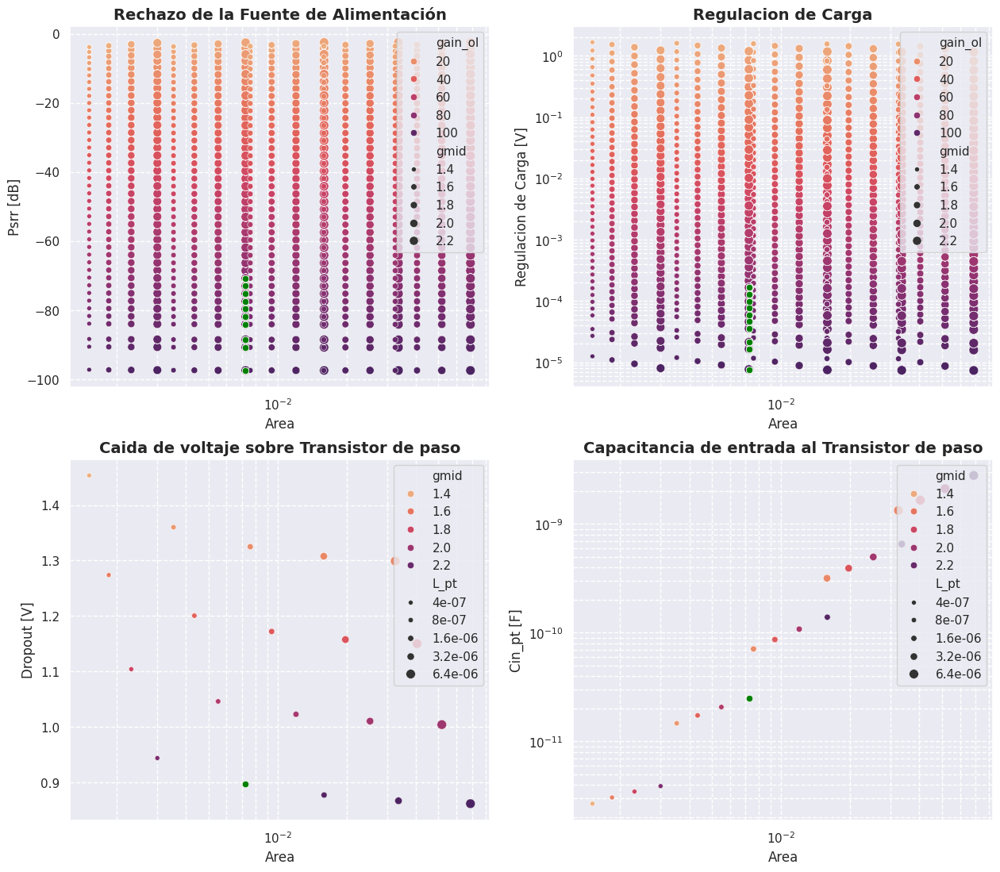

In [54]:
fig, axs = plt.subplots(2, 2, figsize=(15, 13))
sns.scatterplot(ax=axs[0,0], data=ldo_df, x='area', y='psrr', palette='flare', hue='gain_ol', rasterized=True, size='gmid')
sns.scatterplot(ax=axs[0,0], data=df_new, x='area', y='psrr', c='green')
sns.scatterplot(ax=axs[0,1], data=ldo_df, x='area', y='loadreg', palette='flare', rasterized=True, hue='gain_ol', size='gmid')
sns.scatterplot(ax=axs[0,1], data=df_new, x='area', y='loadreg', c='green')
sns.scatterplot(ax=axs[1,0], data=ldo_df, x='area', y=Symbol('dropout'), palette='flare', hue='gmid', rasterized=True, size=Symbol('L_pt'))
sns.scatterplot(ax=axs[1,0], data=df_new, x='area', y=Symbol('dropout'), c='green')
sns.scatterplot(ax=axs[1,1], data=ldo_df, x='area', y=Symbol('Cin_pt'), palette='flare', hue='gmid', rasterized=True, size=Symbol('L_pt'))
sns.scatterplot(ax=axs[1,1], data=df_new, x='area', y=Symbol('Cin_pt'), c='green')

axs[0,0].set_title(r"Rechazo de la Fuente de Alimentación", fontsize=14, weight='bold')
axs[0,0].set_xlabel(r"Area")
axs[0,0].set_ylabel(r"Psrr [dB]")
axs[0,0].locator_params(axis='x', nbins=10) 
axs[0,0].legend(loc = 'upper right')

axs[0,1].set_title(r"Regulacion de Carga", fontsize=14, weight='bold')
axs[0,1].set_xlabel(r"Area")
axs[0,1].set_ylabel(r"Regulacion de Carga [V]")
axs[0,1].legend(loc = 'upper right')

axs[1,0].set_xlabel(r"Area")
axs[1,0].set_ylabel(r"Dropout [V]")
axs[1,0].set_title(r"Caida de voltaje sobre Transistor de paso", fontsize=14, weight='bold')
axs[1,0].legend(loc = 'upper right')

axs[1,1].set_title(r"Capacitancia de entrada al Transistor de paso", fontsize=14, weight='bold')
axs[1,1].set_xlabel(r"Area")
axs[1,1].set_ylabel(r"Cin_pt [F]")
axs[1,1].legend(loc = 'upper right')
#fig.suptitle(r"Ganancias intrínsecas", fontsize=24, y=1.1)

axs[0,0].set_xscale('log')
axs[0,1].set_xscale('log')
axs[1,0].set_xscale('log')
axs[1,1].set_xscale('log')

axs[0,1].set_yscale('log')
axs[1,1].set_yscale('log')


axs[0,0].grid(True,which="both",ls="--")  
axs[0,1].grid(True,which="both",ls="--")  
axs[1,0].grid(True,which="both",ls="--")  
axs[1,1].grid(True,which="both",ls="--")  

plt.savefig('ldo_explore_raw.svg', dpi=120)

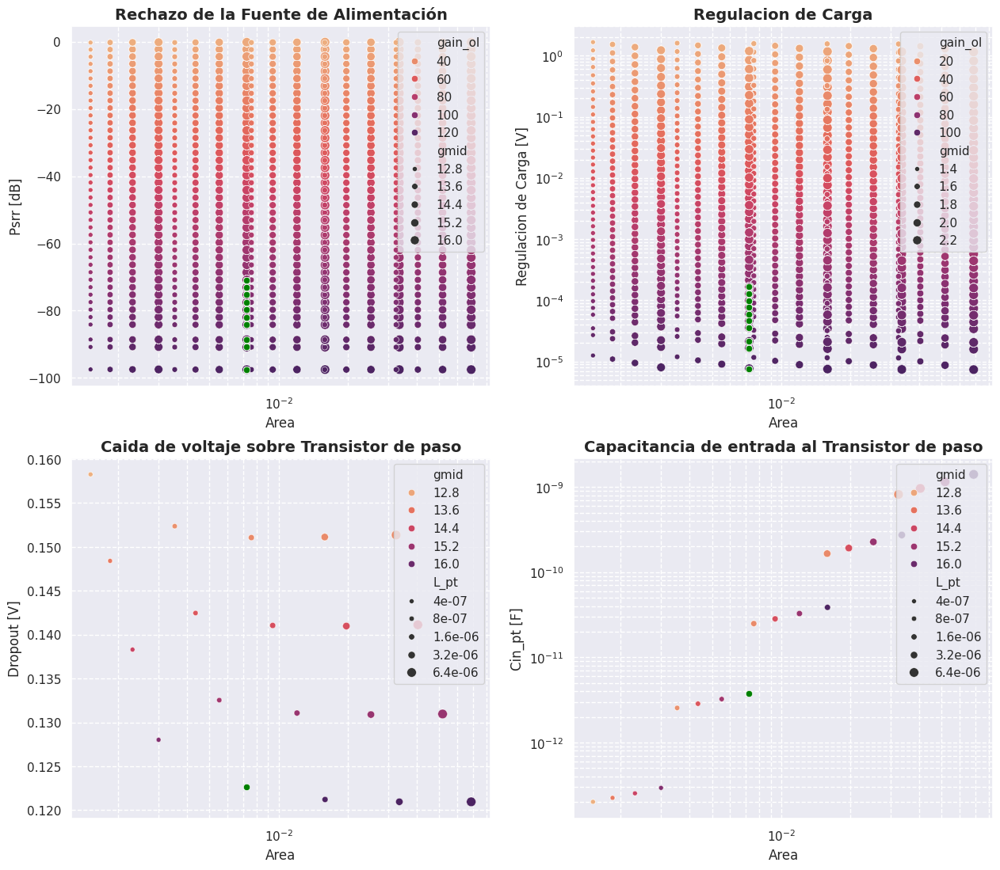

In [55]:
fig, axs = plt.subplots(2, 2, figsize=(15, 13))
sns.scatterplot(ax=axs[0,0], data=ldo_df_wc, x='area', y='psrr', palette='flare', hue='gain_ol', rasterized=True, size='gmid')
sns.scatterplot(ax=axs[0,0], data=df_new_wc, x='area', y='psrr', c='green')
sns.scatterplot(ax=axs[0,1], data=ldo_df, x='area', y='loadreg', palette='flare', rasterized=True, hue='gain_ol', size='gmid')
sns.scatterplot(ax=axs[0,1], data=df_new, x='area', y='loadreg', c='green')
sns.scatterplot(ax=axs[1,0], data=ldo_df_wc, x='area', y=Symbol('dropout'), palette='flare', hue='gmid', rasterized=True, size=Symbol('L_pt'))
sns.scatterplot(ax=axs[1,0], data=df_new_wc, x='area', y=Symbol('dropout'), c='green')
sns.scatterplot(ax=axs[1,1], data=ldo_df_wc, x='area', y=Symbol('Cin_pt'), palette='flare', hue='gmid', rasterized=True, size=Symbol('L_pt'))
sns.scatterplot(ax=axs[1,1], data=df_new_wc, x='area', y=Symbol('Cin_pt'), c='green')

axs[0,0].set_title(r"Rechazo de la Fuente de Alimentación", fontsize=14, weight='bold')
axs[0,0].set_xlabel(r"Area")
axs[0,0].set_ylabel(r"Psrr [dB]")
axs[0,0].locator_params(axis='x', nbins=10) 
axs[0,0].legend(loc = 'upper right')

axs[0,1].set_title(r"Regulacion de Carga", fontsize=14, weight='bold')
axs[0,1].set_xlabel(r"Area")
axs[0,1].set_ylabel(r"Regulacion de Carga [V]")
axs[0,1].legend(loc = 'upper right')

axs[1,0].set_xlabel(r"Area")
axs[1,0].set_ylabel(r"Dropout [V]")
axs[1,0].set_title(r"Caida de voltaje sobre Transistor de paso", fontsize=14, weight='bold')
axs[1,0].legend(loc = 'upper right')

axs[1,1].set_title(r"Capacitancia de entrada al Transistor de paso", fontsize=14, weight='bold')
axs[1,1].set_xlabel(r"Area")
axs[1,1].set_ylabel(r"Cin_pt [F]")
axs[1,1].legend(loc = 'upper right')
#fig.suptitle(r"Ganancias intrínsecas", fontsize=24, y=1.1)

axs[0,0].set_xscale('log')
axs[0,1].set_xscale('log')
axs[1,0].set_xscale('log')
axs[1,1].set_xscale('log')

axs[0,1].set_yscale('log')
axs[1,1].set_yscale('log')


axs[0,0].grid(True,which="both",ls="--")  
axs[0,1].grid(True,which="both",ls="--")  
axs[1,0].grid(True,which="both",ls="--")  
axs[1,1].grid(True,which="both",ls="--")  

plt.savefig('ldo_explore.svg', dpi=120)

# Exploration of OTA

## Preparation

In [56]:
vout_2stage = vout_2stage[0]
Cin_pt = Cin_pt[0]
vout_2stage_wc = vout_2stage_wc[0]
Cin_pt_wc = Cin_pt_wc[0]
print(vout_2stage)
print(Cin_pt)
print(vout_2stage_wc)
print(Cin_pt_wc)

-1.4999999999999996
2.5160347955371574e-11
-0.6676936277218861
3.745909770063829e-12


In [57]:
3.3+vout_2stage

np.float64(1.8000000000000003)

In [58]:
vout_1stage = []
vout_1stage.append(np.linspace(vout_2stage+0.2, vout_2stage-0.6, 5))
vout_1stage = np.asarray(vout_1stage).flatten()
3.3+vout_1stage

array([2. , 1.8, 1.6, 1.4, 1.2])

In [59]:
vout_1stage_wc = []
vout_1stage_wc.append(np.linspace(vout_2stage_wc+0.2, vout_2stage_wc-0.6, 5))
vout_1stage_wc = np.asarray(vout_1stage_wc).flatten()
3.3+vout_1stage_wc

array([2.83230637, 2.63230637, 2.43230637, 2.23230637, 2.03230637])

In [60]:
##############################################################################

stage2_t = cs_pmos()
stage2_t.parameters = {
    Symbol('gm_2stage'): [],
    Symbol('Ro_2stage'): [],
    Symbol('Cin_2stage'): [],
    Symbol("Cgg_2stage"): [],
    Symbol("Cgd_2stage"): [],
    Symbol('vout_2stage'): [],
    Symbol('Cin_pt'): [],
    Symbol('vout_1stage'): []}

stage2_t.outputs = {
    Symbol("W_2stage"): [],
    Symbol("L_2stage"): []}

for vds, vgs, Cout in zip(np.repeat(vout_2stage, 5) ,vout_1stage, np.repeat(Cin_pt, 5)):

    stage2_t_aux = cs_pmos(
        netlist='pmos_cs.spice',
        type='pmos',
        inputs={
            'vds_lut': vds, 
            'vgs_lut': (-2, -0.1, 0.01), 
            'vgs': vgs, 
            'il': OTA_2stage_macro.electrical_parameters["Il"],
            'length': lengths, 
            '2d_var': ['length', 'vgs']})

    stage2_t_aux.build()

    stage2_t.parameters[Symbol('gm_2stage')].append(np.asarray(stage2_t_aux.gm).flatten())
    stage2_t.parameters[Symbol('Ro_2stage')].append(np.asarray(stage2_t_aux.Ro).flatten())
    stage2_t.parameters[Symbol('Cin_2stage')].append(np.asarray(stage2_t_aux.cgg).flatten()+np.asarray(stage2_t_aux.cgd).flatten()*(np.asarray(stage2_t_aux.gm).flatten()*np.asarray(stage2_t_aux.Ro).flatten()))
    stage2_t.parameters[Symbol('Cgg_2stage')].append(np.asarray(stage2_t_aux.cgg).flatten())
    stage2_t.parameters[Symbol('Cgd_2stage')].append(np.asarray(stage2_t_aux.L).flatten())
    stage2_t.parameters[Symbol('vout_2stage')].append(3.3+np.repeat(vds, 5))
    stage2_t.parameters[Symbol('Cin_pt')].append(np.repeat(Cout, 5))
    stage2_t.parameters[Symbol('vout_1stage')].append(3.3+np.repeat(vgs, 5))

    stage2_t.outputs[Symbol('W_2stage')].append(np.asarray(stage2_t_aux.W).flatten())
    stage2_t.outputs[Symbol('L_2stage')].append(np.asarray(stage2_t_aux.L).flatten())

stage2_t.parameters[Symbol('gm_2stage')] = np.asarray(stage2_t.parameters[Symbol('gm_2stage')]).flatten()
stage2_t.parameters[Symbol('Ro_2stage')] = np.asarray(stage2_t.parameters[Symbol('Ro_2stage')]).flatten()
stage2_t.parameters[Symbol('Cin_2stage')] = np.asarray(stage2_t.parameters[Symbol('Cin_2stage')]).flatten()
stage2_t.parameters[Symbol('Cgg_2stage')] = np.asarray(stage2_t.parameters[Symbol('Cgg_2stage')]).flatten()
stage2_t.parameters[Symbol('Cgd_2stage')] = np.asarray(stage2_t.parameters[Symbol('Cgd_2stage')]).flatten()
stage2_t.parameters[Symbol('vout_2stage')] = np.asarray(stage2_t.parameters[Symbol('vout_2stage')]).flatten()
stage2_t.parameters[Symbol('Cin_pt')] = np.asarray(stage2_t.parameters[Symbol('Cin_pt')]).flatten()
stage2_t.parameters[Symbol('vout_1stage')] = np.asarray(stage2_t.parameters[Symbol('vout_1stage')]).flatten()

stage2_t.outputs[Symbol('W_2stage')] = np.asarray(stage2_t.outputs[Symbol('W_2stage')]).flatten()
stage2_t.outputs[Symbol('L_2stage')] = np.asarray(stage2_t.outputs[Symbol('L_2stage')]).flatten()

#################################################################################################################

vs = np.linspace(0.4, 1.5, 5)

currentsource = cm_pmos()
currentsource.parameters = {
    Symbol('gcs'): [],
    Symbol('Rcs'): [],
    Symbol('vs_cs'): [],
    Symbol('vgs_cs'): []}
currentsource.outputs = {
    Symbol("W_cs"): [],
    Symbol("L_cs"): []}


stage2_cs = cm_pmos()
stage2_cs.parameters = {
    Symbol('gcs_2stage'): [],
    Symbol('Rcs_2stage'): [],
    Symbol('vgs_cs_2stage'): []}
stage2_cs.outputs = {
    Symbol("W_cs_2stage"): [],
    Symbol("L_cs_2stage"): []}

for vds_cs in vs:

    vgs_cs = np.linspace(0.2, vds_cs+0.6, 5)

    currentsource_aux = cm_pmos(
        netlist='pmos_cs.spice',
        type='nmos',
        inputs={
            'vds_lut': vds_cs, 
            'vgs_lut': (0.1, 2, 0.01), 
            'vgs': vgs_cs, 
            'il': I_amp1,
            'length': lengths, 
            '2d_var': ['length', 'vgs']})
    currentsource_aux.build()

    currentsource.parameters[Symbol('gcs')].append(np.asarray(currentsource_aux.gm).flatten())
    currentsource.parameters[Symbol('Rcs')].append(np.asarray(currentsource_aux.Ro).flatten())
    currentsource.parameters[Symbol('vs_cs')].append(np.asarray(np.repeat(vds_cs, len(lengths)*len(vgs_cs))).flatten())
    currentsource.parameters[Symbol('vgs_cs')].append(np.asarray(np.tile(vgs_cs, len(lengths))).flatten())
    currentsource.outputs[Symbol('W_cs')].append(np.asarray(currentsource_aux.W).flatten())
    currentsource.outputs[Symbol('L_cs')].append(np.asarray(currentsource_aux.L).flatten())

    for vds_aux in vout_1stage:

        stage2_cs_aux = cm_pmos(
        netlist='pmos_cs.spice',
        type='nmos',
        inputs={
            'vds_lut': 3.3+vds_aux,
            'vgs_lut': (0.1, 2, 0.01),
            'vgs': vgs_cs,
            'il': OTA_2stage_macro.electrical_parameters['Il'],
            'length': lengths,
            '2d_var': ['length', 'vgs']}
            )
        stage2_cs_aux.build()
        
        stage2_cs.parameters[Symbol('gcs_2stage')].append(np.asarray(stage2_cs_aux.gm).flatten())
        stage2_cs.parameters[Symbol('Rcs_2stage')].append(np.asarray(stage2_cs_aux.Ro).flatten())
        stage2_cs.parameters[Symbol('vgs_cs_2stage')].append(np.asarray(np.tile(vgs_cs, len(lengths))).flatten())
        stage2_cs.outputs[Symbol('W_cs_2stage')].append(np.asarray(currentsource_aux.W).flatten())
        stage2_cs.outputs[Symbol('L_cs_2stage')].append(np.asarray(currentsource_aux.L).flatten())


currentsource.parameters[Symbol('gcs')] = np.asarray(currentsource.parameters[Symbol('gcs')]).flatten()
currentsource.parameters[Symbol('Rcs')] = np.asarray(currentsource.parameters[Symbol('Rcs')]).flatten()
currentsource.parameters[Symbol('vs_cs')] = np.asarray(currentsource.parameters[Symbol('vs_cs')]).flatten()
currentsource.parameters[Symbol('vgs_cs')] = np.asarray(currentsource.parameters[Symbol('vgs_cs')]).flatten()
currentsource.outputs[Symbol('W_cs')] = np.asarray(currentsource.outputs[Symbol('W_cs')]).flatten()
currentsource.outputs[Symbol('L_cs')] = np.asarray(currentsource.outputs[Symbol('L_cs')]).flatten()
currentsource.outputs[Symbol('vgs_cs')] = currentsource.parameters[Symbol('vgs_cs')]

stage2_cs.parameters[Symbol('gcs_2stage')]=np.asarray(stage2_cs.parameters[Symbol('gcs_2stage')]).flatten()
stage2_cs.parameters[Symbol('Rcs_2stage')]=np.asarray(stage2_cs.parameters[Symbol('Rcs_2stage')]).flatten()
stage2_cs.parameters[Symbol('vgs_cs_2stage')]=np.asarray(stage2_cs.parameters[Symbol('vgs_cs_2stage')]).flatten()
stage2_cs.outputs[Symbol('W_cs_2stage')]=np.asarray(stage2_cs.outputs[Symbol('W_cs_2stage')]).flatten()
stage2_cs.outputs[Symbol('L_cs_2stage')]=np.asarray(stage2_cs.outputs[Symbol('L_cs_2stage')]).flatten()

length
vgs
0
length
vgs
0
length
vgs
0
length
vgs
0
length
vgs
0
length
vgs
0
length
vgs
0
length
vgs
0
length
vgs
0
length
vgs
0
length
vgs
0
length
vgs
0
length
vgs
0
length
vgs
0
length
vgs
0
length
vgs
0
length
vgs
0
length
vgs
0
length
vgs
0
length
vgs
0
length
vgs
0
length
vgs
0
length
vgs
0
length
vgs
0
length
vgs
0
length
vgs
0
length
vgs
0
length
vgs
0
length
vgs
0
length
vgs
0
length
vgs
0
length
vgs
0
length
vgs
0
length
vgs
0
length
vgs
0


In [61]:
##############################################################################

stage2_t = cs_pmos()
stage2_t.parameters = {
    Symbol('gm_2stage'): [],
    Symbol('Ro_2stage'): [],
    Symbol('Cin_2stage'): [],
    Symbol("Cgg_2stage"): [],
    Symbol("Cgd_2stage"): [],
    Symbol('vout_2stage'): [],
    Symbol('Cin_pt'): [],
    Symbol('vout_1stage'): []}

stage2_t.outputs = {
    Symbol("W_2stage"): [],
    Symbol("L_2stage"): []}

for vds, vgs, Cout in zip(np.repeat(vout_2stage, 5) ,vout_1stage, np.repeat(Cin_pt, 5)):

    stage2_t_aux = cs_pmos(
        netlist='pmos_cs.spice',
        type='pmos',
        inputs={
            'vds_lut': vds, 
            'vgs_lut': (-2, -0.1, 0.01), 
            'vgs': vgs, 
            'il': OTA_2stage_macro.electrical_parameters["Il"],
            'length': lengths, 
            '2d_var': ['length', 'vgs']})

    stage2_t_aux.build()

    stage2_t.parameters[Symbol('gm_2stage')].append(np.asarray(stage2_t_aux.gm).flatten())
    stage2_t.parameters[Symbol('Ro_2stage')].append(np.asarray(stage2_t_aux.Ro).flatten())
    stage2_t.parameters[Symbol('Cin_2stage')].append(np.asarray(stage2_t_aux.cgg).flatten()+np.asarray(stage2_t_aux.cgd).flatten()*(np.asarray(stage2_t_aux.gm).flatten()*np.asarray(stage2_t_aux.Ro).flatten()))
    stage2_t.parameters[Symbol('Cgg_2stage')].append(np.asarray(stage2_t_aux.cgg).flatten())
    stage2_t.parameters[Symbol('Cgd_2stage')].append(np.asarray(stage2_t_aux.L).flatten())
    stage2_t.parameters[Symbol('vout_2stage')].append(3.3+np.repeat(vds, 5))
    stage2_t.parameters[Symbol('Cin_pt')].append(np.repeat(Cout, 5))
    stage2_t.parameters[Symbol('vout_1stage')].append(3.3+np.repeat(vgs, 5))

    stage2_t.outputs[Symbol('W_2stage')].append(np.asarray(stage2_t_aux.W).flatten())
    stage2_t.outputs[Symbol('L_2stage')].append(np.asarray(stage2_t_aux.L).flatten())

stage2_t.parameters[Symbol('gm_2stage')] = np.asarray(stage2_t.parameters[Symbol('gm_2stage')]).flatten()
stage2_t.parameters[Symbol('Ro_2stage')] = np.asarray(stage2_t.parameters[Symbol('Ro_2stage')]).flatten()
stage2_t.parameters[Symbol('Cin_2stage')] = np.asarray(stage2_t.parameters[Symbol('Cin_2stage')]).flatten()
stage2_t.parameters[Symbol('Cgg_2stage')] = np.asarray(stage2_t.parameters[Symbol('Cgg_2stage')]).flatten()
stage2_t.parameters[Symbol('Cgd_2stage')] = np.asarray(stage2_t.parameters[Symbol('Cgd_2stage')]).flatten()
stage2_t.parameters[Symbol('vout_2stage')] = np.asarray(stage2_t.parameters[Symbol('vout_2stage')]).flatten()
stage2_t.parameters[Symbol('Cin_pt')] = np.asarray(stage2_t.parameters[Symbol('Cin_pt')]).flatten()
stage2_t.parameters[Symbol('vout_1stage')] = np.asarray(stage2_t.parameters[Symbol('vout_1stage')]).flatten()

stage2_t.outputs[Symbol('W_2stage')] = np.asarray(stage2_t.outputs[Symbol('W_2stage')]).flatten()
stage2_t.outputs[Symbol('L_2stage')] = np.asarray(stage2_t.outputs[Symbol('L_2stage')]).flatten()

#################################################################################################################

vs = np.linspace(0.3, 1.5, 5)

currentsource = cm_pmos()
currentsource.parameters = {
    Symbol('gcs'): [],
    Symbol('Rcs'): [],
    Symbol('vs_cs'): [],
    Symbol('vgs_cs'): []}
currentsource.outputs = {
    Symbol("W_cs"): [],
    Symbol("L_cs"): []}


stage2_cs = cm_pmos()
stage2_cs.parameters = {
    Symbol('gcs_2stage'): [],
    Symbol('Rcs_2stage'): [],
    Symbol('vgs_cs_2stage'): []}
stage2_cs.outputs = {
    Symbol("W_cs_2stage"): [],
    Symbol("L_cs_2stage"): []}

for vds_cs in vs:

    vgs_cs = np.linspace(0.1, vds_cs+0.6, 5)

    currentsource_aux = cm_pmos(
        netlist='pmos_cs.spice',
        type='nmos',
        inputs={
            'vds_lut': vds_cs, 
            'vgs_lut': (0.1, 2, 0.01), 
            'vgs': vgs_cs, 
            'il': I_amp1,
            'length': lengths, 
            '2d_var': ['length', 'vgs']})
    currentsource_aux.build()

    currentsource.parameters[Symbol('gcs')].append(np.asarray(currentsource_aux.gm).flatten())
    currentsource.parameters[Symbol('Rcs')].append(np.asarray(currentsource_aux.Ro).flatten())
    currentsource.parameters[Symbol('vs_cs')].append(np.asarray(np.repeat(vds_cs, len(lengths)*len(vgs_cs))).flatten())
    currentsource.parameters[Symbol('vgs_cs')].append(np.asarray(np.tile(vgs_cs, len(lengths))).flatten())
    currentsource.outputs[Symbol('W_cs')].append(np.asarray(currentsource_aux.W).flatten())
    currentsource.outputs[Symbol('L_cs')].append(np.asarray(currentsource_aux.L).flatten())

    for vds_aux in vout_1stage:

        stage2_cs_aux = cm_pmos(
        netlist='pmos_cs.spice',
        type='nmos',
        inputs={
            'vds_lut': 3.3+vds_aux,
            'vgs_lut': (0.1, 2, 0.01),
            'vgs': vgs_cs,
            'il': OTA_2stage_macro.electrical_parameters['Il'],
            'length': lengths,
            '2d_var': ['length', 'vgs']}
            )
        stage2_cs_aux.build()
        
        stage2_cs.parameters[Symbol('gcs_2stage')].append(np.asarray(stage2_cs_aux.gm).flatten())
        stage2_cs.parameters[Symbol('Rcs_2stage')].append(np.asarray(stage2_cs_aux.Ro).flatten())
        stage2_cs.parameters[Symbol('vgs_cs_2stage')].append(np.asarray(np.tile(vgs_cs, len(lengths))).flatten())
        stage2_cs.outputs[Symbol('W_cs_2stage')].append(np.asarray(currentsource_aux.W).flatten())
        stage2_cs.outputs[Symbol('L_cs_2stage')].append(np.asarray(currentsource_aux.L).flatten())


currentsource.parameters[Symbol('gcs')] = np.asarray(currentsource.parameters[Symbol('gcs')]).flatten()
currentsource.parameters[Symbol('Rcs')] = np.asarray(currentsource.parameters[Symbol('Rcs')]).flatten()
currentsource.parameters[Symbol('vs_cs')] = np.asarray(currentsource.parameters[Symbol('vs_cs')]).flatten()
currentsource.parameters[Symbol('vgs_cs')] = np.asarray(currentsource.parameters[Symbol('vgs_cs')]).flatten()
currentsource.outputs[Symbol('W_cs')] = np.asarray(currentsource.outputs[Symbol('W_cs')]).flatten()
currentsource.outputs[Symbol('L_cs')] = np.asarray(currentsource.outputs[Symbol('L_cs')]).flatten()
currentsource.outputs[Symbol('vgs_cs')] = currentsource.parameters[Symbol('vgs_cs')]

stage2_cs.parameters[Symbol('gcs_2stage')]=np.asarray(stage2_cs.parameters[Symbol('gcs_2stage')]).flatten()
stage2_cs.parameters[Symbol('Rcs_2stage')]=np.asarray(stage2_cs.parameters[Symbol('Rcs_2stage')]).flatten()
stage2_cs.parameters[Symbol('vgs_cs_2stage')]=np.asarray(stage2_cs.parameters[Symbol('vgs_cs_2stage')]).flatten()
stage2_cs.outputs[Symbol('W_cs_2stage')]=np.asarray(stage2_cs.outputs[Symbol('W_cs_2stage')]).flatten()
stage2_cs.outputs[Symbol('L_cs_2stage')]=np.asarray(stage2_cs.outputs[Symbol('L_cs_2stage')]).flatten()

length
vgs
0
length
vgs
0
length
vgs
0
length
vgs
0
length
vgs
0
length
vgs
0
length
vgs
0
length
vgs
0
length
vgs
0
length
vgs
0
length
vgs
0
length
vgs
0
length
vgs
0
length
vgs
0
length
vgs
0
length
vgs
0
length
vgs
0
length
vgs
0
length
vgs
0
length
vgs
0
length
vgs
0
length
vgs
0
length
vgs
0
length
vgs
0
length
vgs
0
length
vgs
0
length
vgs
0
length
vgs
0
length
vgs
0
length
vgs
0
length
vgs
0
length
vgs
0
length
vgs
0
length
vgs
0
length
vgs
0


## Nominal

In [62]:
OTA_2stage_macro.primitives = [stage2_t, stage2_cs]
OTA_2stage_macro.submacromodels = [OTA_1stage_macro]
OTA_2stage_macro.num_level_exp = 1
OTA_2stage_macro.specifications = [gain_2stage_OTA, rout_2stage_OTA, gm_2stage_OTA, phase_margin_2stage_OTA]
OTA_2stage_macro.opt_specifications = [gain_2stage_OTA]
OTA_2stage_macro.is_primitive = 0
OTA_2stage_macro.run_pareto = False

ota_2stage_results, ota_2stage_axes, ota_2stage_primouts, ota_2stage_df, _ = dfs(OTA_2stage_macro, debug = False)

############################################
Starting the exploration of:  OTA_2stage_macro
Netlist:  OTA_2stage
Running MNA... 
   vdd  vout  net1  vss  vpos
0    1     2     3    0     4
[['vout', 'vpos']]
Netlist:  OTA_2stage_rout
Running MNA... 
   vdd  vout  net1  vss  vpos  vr
0    1     2     3    0     4   5
[['vout', 'vr']]
Netlist:  ota_2stage
Running MNA... 
   vdd  vout  net1  vss  vpos
0    1     2     3    0     4
[['vout', 'vpos']]
Netlist:  ota_2stage
Running MNA... 
   vdd  vout  net1  vss  vpos
0    1     2     3    0     4
[['vout', 'vpos']]
in eval
-Ra_1stage*Rcs_2stage*Ro_2stage*gm_2stage*gma_1stage/(Rcs_2stage + Ro_2stage)
#### creating the primods_list ####
mod:  <sstadex.models.macromodel.Macromodel object at 0x7fab79e19240>
mod:  <sstadex.models.primitives.cs_pmos object at 0x7fab000f1e10>
mod:  <sstadex.models.primitives.cm_pmos object at 0x7fab000f2380>
primmods_outputs_aux:  {W_2stage: array([1.96557195e-06, 4.82049322e-06, 1.06612445e-05, 2.25652507e-05,
  

KeyboardInterrupt: 

## Filtering

In [ ]:
ota_2stage_df['gain'] = 20*np.log10(ota_2stage_df['gain_2stage'])
ota_2stage_df['fc'] = 1/(ota_2stage_df[Symbol('Cin_2stage')]*ota_2stage_df[Symbol('Ra_1stage')]*2*np.pi)
ota_2stage_df['fc2'] = 1/(ota_2stage_df[Symbol('Cin_pt')]*ota_2stage_df['rout_2stage']*2*np.pi)


df_new = ota_2stage_df[(ldo_df[Symbol('W_2stage')]<1e-3) & (ota_2stage_df[Symbol('W_cs_2stage')]<1e-3)]
df_new.sort_values(by='fc', ascending=False)

/tmp/ipykernel_60104/1653489788.py:6: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_new = ota_2stage_df[(ldo_df[Symbol('W_2stage')]<1e-3) & (ota_2stage_df[Symbol('W_cs_2stage')]<1e-3)]


,Ra_1stage,gma_1stage,gm_2stage,Ro_2stage,Cin_2stage,Cgg_2stage,Cgd_2stage,vout_2stage,Cin_pt,vout_1stage,...,rout_2stage,gm_2stage,W_2stage,L_2stage,W_cs_2stage,L_cs_2stage,area,gain,fc,fc2
146550,1000.0,0.010000,0.000191,6.035399e+05,4.862090e-15,6.927192e-15,4.000000e-07,2.000000,6.878812e-12,2.300000,...,5.273181e+05,0.001912,0.000006,4.000000e-07,0.000014,0.000006,0.000027,60.070729,3.273385e+10,43876.706063
149760,1000.0,0.010000,0.000191,6.035399e+05,4.862090e-15,6.927192e-15,4.000000e-07,2.000000,6.878812e-12,2.300000,...,5.563748e+05,0.001912,0.000006,4.000000e-07,0.000008,0.000006,0.000021,60.536624,3.273385e+10,41585.242007
152132,1000.0,0.010000,0.000191,6.035399e+05,4.862090e-15,6.927192e-15,4.000000e-07,2.000000,6.878812e-12,2.300000,...,5.214390e+05,0.001912,0.000006,4.000000e-07,0.000020,0.000006,0.000033,59.973345,3.273385e+10,44371.408283
149139,1000.0,0.010000,0.000191,6.035399e+05,4.862090e-15,6.927192e-15,4.000000e-07,2.000000,6.878812e-12,2.300000,...,5.241842e+05,0.001912,0.000006,4.000000e-07,0.000017,0.000006,0.000029,60.018953,3.273385e+10,44139.030456
150547,1000.0,0.010000,0.000191,6.035399e+05,4.862090e-15,6.927192e-15,4.000000e-07,2.000000,6.878812e-12,2.300000,...,5.576335e+05,0.001912,0.000006,4.000000e-07,0.000008,0.000006,0.000021,60.556252,3.273385e+10,41491.375475
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
17627,10000000.0,0.000010,0.000961,1.086053e+07,4.063036e-10,4.013607e-10,6.400000e-06,2.133333,8.028080e-12,2.733333,...,1.595763e+06,0.096083,0.037221,6.400000e-06,0.000488,0.000006,0.037721,103.712292,3.917143e+01,12423.385699
138308,10000000.0,0.001778,0.000961,1.086053e+07,4.063036e-10,4.013607e-10,6.400000e-06,2.133333,8.028080e-12,2.733333,...,3.344828e+06,17.086226,0.037221,6.400000e-06,0.000006,0.000006,0.037239,155.140399,3.917143e+01,5926.995753
191062,10000000.0,0.010000,0.000961,1.086053e+07,4.063036e-10,4.013607e-10,6.400000e-06,2.133333,8.028080e-12,2.733333,...,1.104573e+06,96.082911,0.037221,6.400000e-06,0.000055,0.000003,0.037286,160.516809,3.917143e+01,17947.921335
89886,10000000.0,0.000316,0.000961,1.086053e+07,4.063036e-10,4.013607e-10,6.400000e-06,2.133333,8.028080e-12,2.733333,...,1.064385e+06,3.038408,0.037221,6.400000e-06,0.000055,0.000003,0.037286,130.194901,3.917143e+01,18625.568975


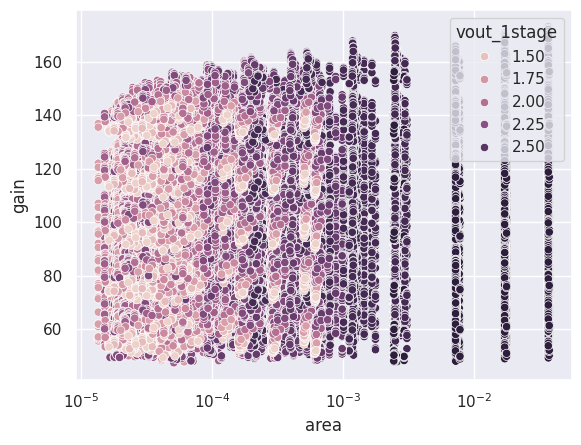

In [ ]:
sns.scatterplot(data=df_new, x='area', y='gain', hue=Symbol('vout_1stage'))
plt.xscale('log')

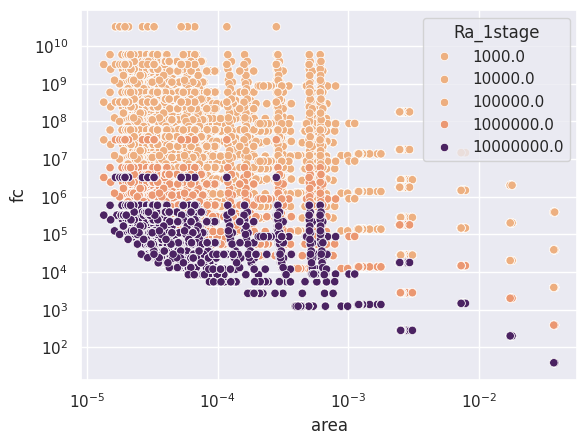

In [ ]:
sns.scatterplot(data=df_new, x='area', y='fc', palette='flare', hue=Symbol('Ra_1stage'), rasterized=True)
plt.xscale('log')
plt.yscale('log')

/tmp/ipykernel_60104/918154933.py:4: UserWarning: Ignoring `palette` because no `hue` variable has been assigned.
  sns.scatterplot(ax=axs[2], data=df_new, x='area', y='fc', palette='flare', rasterized=True)


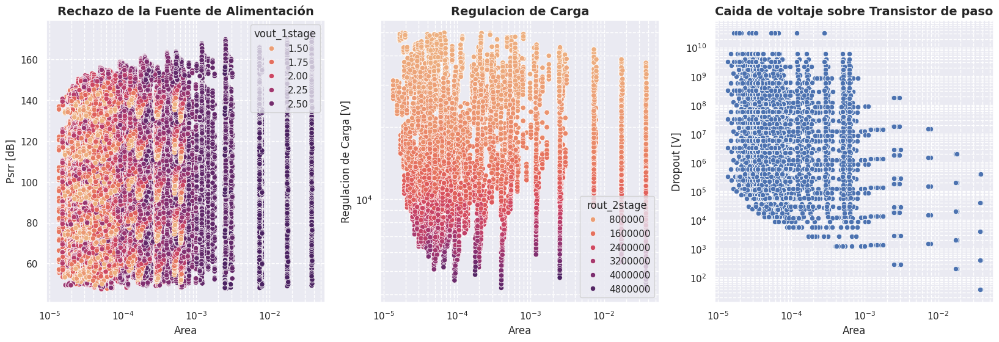

In [ ]:
fig, axs = plt.subplots(1, 3, figsize=(20, 6))
sns.scatterplot(ax=axs[0], data=df_new, x='area', y='gain', palette='flare', hue=Symbol('vout_1stage'), rasterized=True)
sns.scatterplot(ax=axs[1], data=df_new, x='area', y='fc2', palette='flare', rasterized=True, hue='rout_2stage')
sns.scatterplot(ax=axs[2], data=df_new, x='area', y='fc', palette='flare', rasterized=True)
#sns.scatterplot(ax=axs[1,1], data=ldo_df, x='area', y=Symbol('Cin_pt'), palette='flare', hue=Symbol('L_pt'), rasterized=True)

axs[0].set_title(r"Rechazo de la Fuente de Alimentación", fontsize=14, weight='bold')
axs[0].set_xlabel(r"Area")
axs[0].set_ylabel(r"Psrr [dB]")
axs[0].locator_params(axis='x', nbins=10) 

axs[1].set_title(r"Regulacion de Carga", fontsize=14, weight='bold')
axs[1].set_xlabel(r"Area")
axs[1].set_ylabel(r"Regulacion de Carga [V]")

axs[2].set_xlabel(r"Area")
axs[2].set_ylabel(r"Dropout [V]")
axs[2].set_title(r"Caida de voltaje sobre Transistor de paso", fontsize=14, weight='bold')

axs[0].set_xscale('log')
axs[1].set_xscale('log')
axs[2].set_xscale('log')

axs[1].set_yscale('log')
axs[2].set_yscale('log')


axs[0].grid(True,which="both",ls="--")  
axs[1].grid(True,which="both",ls="--")  
axs[2].grid(True,which="both",ls="--")  

plt.savefig('ldo_explore_raw.svg', dpi=120)

# OTA 1stage

## Preparation

In [ ]:
vds_diffpar = OTA_1stage_macro.electrical_parameters["Vout"] - vs
vgs_diffpar = OTA_1stage_macro.electrical_parameters["Vref"] - vs

diffpair = simplediffpair(
    netlist='diffpair.spice',
    type='nmos',
    inputs = {
        'vds_lut': (0.1, 2, 0.01),
        'vgs_lut': (0.1, 2.2, 0.01), 
        'vds': vds_diffpar, 
        'vgs': vgs_diffpar, 
        'il': I_amp1/2,
        'length': lengths, 
        '2d_var': ['vds', 'vgs']}
)

diffpair.build()

diffpair.parameters = {
    Symbol('gdiff_1'): np.asarray(diffpair.gm).flatten(),
    Symbol('Rdiff_1'): np.asarray(diffpair.Ro).flatten(),
    Symbol("vs_diff"): np.tile(np.asarray(vs), len(lengths))}

diffpair.outputs = {
    Symbol("W_diff"): np.asarray(diffpair.W).flatten(),
    Symbol("L_diff"): np.asarray(diffpair.L).flatten()}

##############################################################################

activeload = cm_pmos(
    netlist='pmos_cs.spice',
    type='pmos',
    inputs={
        'vds_lut': OTA_1stage_macro.electrical_parameters["Vout"]-OTA_1stage_macro.electrical_parameters["Vdd"], 
        'vgs_lut': (-1.8, -0.1, 0.01), 
        'vgs': OTA_1stage_macro.electrical_parameters["Vout"]-OTA_1stage_macro.electrical_parameters["Vdd"], 
        'il': I_amp1/2,
        'length': lengths, 
        '2d_var': ['length', 'vgs']})

activeload.build()

activeload.parameters = {
    Symbol('gaload_1'): np.asarray(activeload.gm).flatten(),
    Symbol('Raload_1'): np.asarray(activeload.Ro).flatten()}

activeload.outputs = {
    Symbol("W_al"): np.asarray(activeload.W).flatten(),
    Symbol("L_al"): np.asarray(activeload.L).flatten()}

vds
vgs
1
length
vgs
0


## Nominal

In [ ]:
OTA_1stage_macro.primitives = [diffpair, activeload, currentsource]
OTA_1stage_macro.submacromodels = [] 
OTA_1stage_macro.num_level_exp = 1
OTA_1stage_macro.specifications = [gain_1stage_OTA, rout_1stage_OTA, gm_1stage_OTA]
OTA_1stage_macro.opt_specifications = [gain_1stage_OTA]
OTA_1stage_macro.is_primitive = 0
OTA_1stage_macro.run_pareto = True

ldo_results, ldo_axes, ldo_primouts, ldo_df, _ , _= dfs(OTA_1stage_macro, debug = False)

############################################
Starting the exploration of:  ota_1stage
Netlist:  ota_1stage
Running MNA... 
   net1  vs  vneg  vout  vpos  vdd  vss
0     1   2     3     4     5    6    0
[('vout', 'vpos')]
Netlist:  ota_1stage_rout
Running MNA... 
   net1  vs  vneg  vout  vpos  vdd  vss  vr
0     1   2     3     4     5    6    0   7
[['vout', 'vr']]
Netlist:  ota_1stage
Running MNA... 
   net1  vs  vneg  vout  vpos  vdd  vss
0     1   2     3     4     5    6    0
[['vout', 'vpos']]
in eval
#### creating the primods_list ####
mod:  <sstadex.models.primitives.simplediffpair object at 0x7f75cbfe6d40>
mod:  <sstadex.models.primitives.cm_pmos object at 0x7f75d02dd570>
mod:  <sstadex.models.primitives.cm_pmos object at 0x7f765411d300>
primmods_outputs_aux:  {W_diff: array([5.32753724e-07, 7.11325561e-07, 1.00088473e-06, 1.50816620e-06,
       2.49152899e-06, 4.68286013e-06, 1.06211440e-05, 3.18094256e-05,
       1.35132393e-04, 7.43463176e-04, 4.40954824e-03, 2.61347488e-02

## Filtering

In [ ]:
ldo_df['gain'] = 20*np.log10(ldo_df['gain_1stage'])
ldo_df
#df_new = ldo_df[ldo_df['rout_1stage']<464158.8833612772]

,gdiff_1,Rdiff_1,vs_diff,gaload_1,Raload_1,gcs,Rcs,vs_cs,vgs_cs,gain_1stage,rout_1stage,gm_1stage,W_diff,L_diff,W_al,L_al,W_cs,L_cs,area,gain
955,0.000157,5.420248e+05,0.489474,0.000037,2.251707e+07,0.000115,9.219512e+04,0.489474,1.289474,83.243985,5.419579e+05,0.000154,0.000005,8.000000e-07,0.000009,0.000006,0.000005,3.200000e-06,0.000030,38.407057
2221,0.000121,1.334361e+06,0.426316,0.000037,2.251707e+07,0.000248,1.087642e+05,0.426316,0.944737,152.348887,1.271931e+06,0.000120,0.000006,1.600000e-06,0.000009,0.000006,0.000006,8.000000e-07,0.000031,43.656786
3665,0.000089,3.427062e+06,0.300000,0.000037,2.251707e+07,0.000151,2.772917e+04,0.300000,1.100000,263.821859,2.984058e+06,0.000088,0.000006,3.200000e-06,0.000009,0.000006,0.000006,1.600000e-06,0.000032,48.426216
3857,0.000101,3.021135e+06,0.363158,0.000037,2.251707e+07,0.000283,8.448413e+04,0.363158,0.897368,267.668196,2.674929e+06,0.000100,0.000008,3.200000e-06,0.000009,0.000006,0.000009,8.000000e-07,0.000037,48.551935
4051,0.000116,2.630662e+06,0.426316,0.000037,2.251707e+07,0.000248,1.087642e+05,0.426316,0.944737,272.089657,2.367046e+06,0.000115,0.000012,3.200000e-06,0.000009,0.000006,0.000006,8.000000e-07,0.000038,48.694241
4056,0.000116,2.630662e+06,0.426316,0.000037,2.251707e+07,0.000125,6.744858e+04,0.426316,1.226316,272.093258,2.366779e+06,0.000115,0.000012,3.200000e-06,0.000009,0.000006,0.000007,3.200000e-06,0.000040,48.694356
5495,0.000087,6.668702e+06,0.300000,0.000037,2.251707e+07,0.000151,2.772917e+04,0.300000,1.100000,448.994530,5.153553e+06,0.000087,0.000012,6.400000e-06,0.000009,0.000006,0.000006,1.600000e-06,0.000042,53.044821
5687,0.000099,5.882208e+06,0.363158,0.000037,2.251707e+07,0.000283,8.448413e+04,0.363158,0.897368,459.793369,4.673908e+06,0.000098,0.000017,6.400000e-06,0.000009,0.000006,0.000009,8.000000e-07,0.000048,53.251254
5692,0.000099,5.882208e+06,0.363158,0.000037,2.251707e+07,0.000134,4.129947e+04,0.363158,1.163158,459.807882,4.673344e+06,0.000098,0.000017,6.400000e-06,0.000009,0.000006,0.000008,3.200000e-06,0.000050,53.251528
5881,0.000113,5.128944e+06,0.426316,0.000037,2.251707e+07,0.000248,1.087642e+05,0.426316,0.944737,471.796681,4.187932e+06,0.000113,0.000023,6.400000e-06,0.000009,0.000006,0.000006,8.000000e-07,0.000052,53.475098


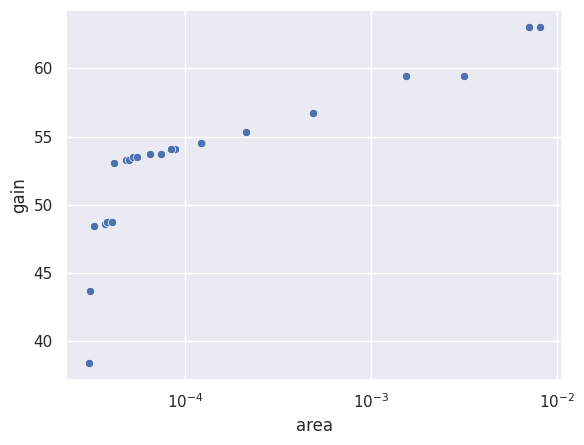

In [ ]:
sns.scatterplot(data=ldo_df, x='area', y='gain')
#sns.scatterplot(data=df_new, x='area', y='gain')
plt.xscale('log')

In [ ]:
OTA_2stage_macro.primitives = [stage2_t, stage2_cs]
OTA_2stage_macro.submacromodels = [OTA_1stage_macro]
OTA_2stage_macro.num_level_exp = -1
OTA_2stage_macro.specifications = [gain_2stage_OTA]
OTA_2stage_macro.opt_specifications = [gain_2stage_OTA]
OTA_2stage_macro.is_primitive = 0
OTA_2stage_macro.run_pareto = False

OTA_1stage_macro.primitives = [diffpair, activeload, currentsource]
OTA_1stage_macro.submacromodels = [] 
OTA_1stage_macro.num_level_exp = 1
OTA_1stage_macro.specifications = [gain_1stage_OTA, rout_1stage_OTA, gm_1stage_OTA]
OTA_1stage_macro.opt_specifications = [gain_1stage_OTA]
OTA_1stage_macro.is_primitive = 0

ldo_results, ldo_axes, ldo_primouts, ldo_df, _ = dfs(OTA_2stage_macro, debug = False)

############################################
Starting the exploration of:  ota_2stage
Netlist:  OTA_2stage
Running MNA... 
   vdd  vout  net1  vss  vpos
0    1     2     3    0     4
[['vout', 'vpos']]
in eval
#### creating the primods_list ####
mod:  <sstadex.models.macromodel.Macromodel object at 0x7f75d2c405b0>
mod:  <sstadex.models.primitives.cs_pmos object at 0x7f75c97bf2b0>
mod:  <sstadex.models.primitives.cm_pmos object at 0x7f75d045c250>
primmods_outputs_aux:  {W_2stage: array([4.57340129e-04, 2.44253457e-03, 7.25478059e-03, 1.72527178e-02,
       3.72206488e-02, 5.45717218e-05, 1.97632903e-04, 5.15725587e-04,
       1.17036991e-03, 2.48056122e-03, 1.58194859e-05, 4.61865707e-05,
       1.10197653e-04, 2.41404104e-04, 5.04756802e-04, 6.97124527e-06,
       1.85199679e-05, 4.24704558e-05, 9.14963217e-05, 1.90013582e-04,
       3.83787089e-06, 9.71550863e-06, 2.18262633e-05, 4.65799315e-05,
       9.63337384e-05, 2.42064561e-06, 5.94820182e-06, 1.31907161e-05,
       2.79717641e-

In [ ]:
ldo_df['gain'] = 20*np.log10(ldo_df['gain_2stage'])
ldo_df['fc'] = 1/(ldo_df[Symbol('Cin_2stage')]*ldo_df[Symbol('Ra_1stage')]*2*np.pi)

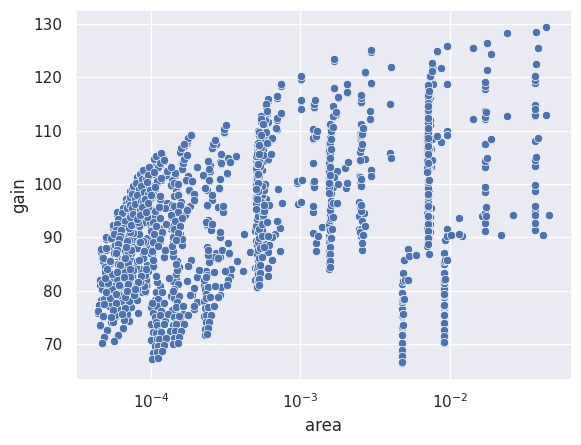

In [ ]:
sns.scatterplot(data=ldo_df, x='area', y='gain')
#sns.scatterplot(data=df_new, x='area', y='gain')
plt.xscale('log')

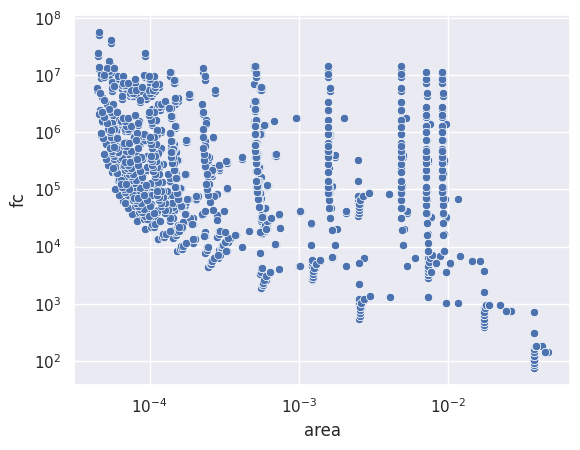

In [ ]:
sns.scatterplot(data=ldo_df, x='area', y='fc')
#sns.scatterplot(data=df_new, x='area', y='gain')
plt.xscale('log')
plt.yscale('log')